In [8]:
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from functions_pca import *
from functions import *

In [9]:
#Import dataset

In [10]:
dg_init = pd.read_pickle('dataset_segmentation.pkl')

In [11]:
dg_init.head()

,nb_of_orders,payment_type_boleto,payment_type_debit_card,payment_type_credit_card,payment_type_voucher,nb_payments,nb_days_since_last_order,delivery_nb_of_days,payment_value,nb_items,...,category_hobbies,category_furnitures_deco,category_food,category_fashion_beauty,category_electronic,category_diy,category_auto,category_services,category_accessories,dimensions
customer_unique_id,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,0.0,0.0,1.0,0.0,1.0,111,6.0,141.90,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34816.0
0000b849f77a49e4a4ce2b2a4ca5be3f,1,0.0,0.0,1.0,0.0,1.0,114,3.0,27.19,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,8424.0
0000f46a3911fa3c0805444483337064,1,0.0,0.0,1.0,0.0,1.0,536,25.0,86.22,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,30625.0
0000f6ccb0745a6a4b88665a16c9f078,1,0.0,0.0,1.0,0.0,1.0,320,20.0,43.62,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2299.0
0004aac84e0df4da2b147fca70cf8255,1,0.0,0.0,1.0,0.0,1.0,287,13.0,196.89,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1936.0


### First segmentation

In [6]:
dg=dg_init[['nb_of_orders',
       'payment_type_boleto',
       'payment_type_debit_card',
       'payment_type_credit_card',
       'payment_type_voucher',
       'nb_payments',
       'nb_days_since_last_order',
       'delivery_nb_of_days',
       'payment_value',
       'nb_items',
       'review_score',
       'city_density',
       'dimensions']]

We are going to try a KMeans segmentation with the variable defined above.

In [7]:
X=dg.values

In [12]:
from sklearn import preprocessing
from sklearn import cluster, metrics

In [9]:
#standardize data
std_sc=preprocessing.StandardScaler()
X_norm=std_sc.fit_transform(X)

In [10]:
dg.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92733 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   nb_of_orders              92733 non-null  int64  
 1   payment_type_boleto       92733 non-null  float64
 2   payment_type_debit_card   92733 non-null  float64
 3   payment_type_credit_card  92733 non-null  float64
 4   payment_type_voucher      92733 non-null  float64
 5   nb_payments               92733 non-null  float64
 6   nb_days_since_last_order  92733 non-null  int64  
 7   delivery_nb_of_days       92733 non-null  float64
 8   payment_value             92733 non-null  float64
 9   nb_items                  92733 non-null  float64
 10  review_score              92733 non-null  float64
 11  city_density              92733 non-null  float64
 12  dimensions                92733 non-null  float64
dtypes: float

In [11]:
#we remove values of the variable payment_value where z-score is >=5

dg=dg[(np.abs(X_norm[:,8])<5)]

X_norm=X_norm[(np.abs(X_norm[:,8])<5)]

In [12]:
X_norm.shape

(92088, 13)

In [13]:
dg.shape

(92088, 13)

In [15]:
# We look for the best value of K.

In [16]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

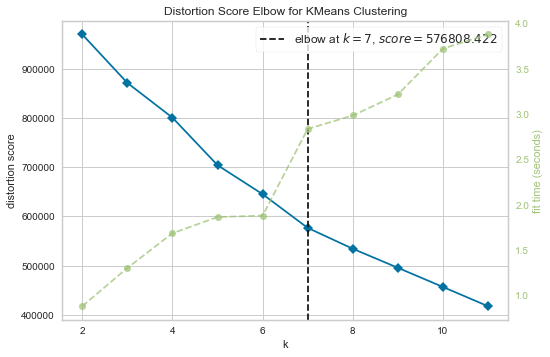

In [17]:
model = cluster.KMeans()
visualizer = KElbowVisualizer(model, k=(2,12))

visualizer.fit(X_norm)    # Fit the data to the visualizer
visualizer.poof() 

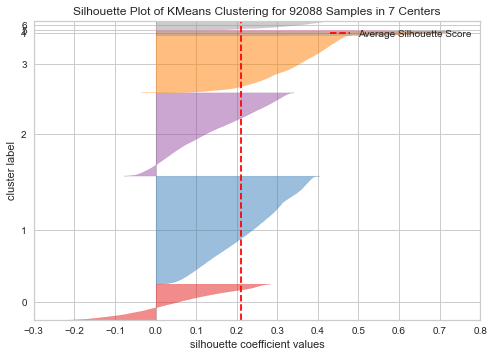

In [18]:
#silhouette plot with K=7
model = cluster.KMeans(7)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X_norm)  
visualizer.poof()  

In [14]:
cls=cluster.KMeans(n_clusters=7,random_state=0)
cls.fit(X_norm)

KMeans(n_clusters=7, random_state=0)

In [15]:
dg['num_cluster']=cls.labels_

In [16]:
dg['num_cluster'].value_counts()

4    48414
2    17738
0    10847
3    10666
1     2477
5     1431
6      515
Name: num_cluster, dtype: int64

In [17]:
dg

,nb_of_orders,payment_type_boleto,payment_type_debit_card,payment_type_credit_card,payment_type_voucher,nb_payments,nb_days_since_last_order,delivery_nb_of_days,payment_value,nb_items,review_score,city_density,dimensions,num_cluster
customer_unique_id,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,0.0,0.0,1.0,0.0,1.0,111,6.0,141.90,1.0,5.0,0.105103,34816.0,4
0000b849f77a49e4a4ce2b2a4ca5be3f,1,0.0,0.0,1.0,0.0,1.0,114,3.0,27.19,1.0,4.0,0.776307,8424.0,4
0000f46a3911fa3c0805444483337064,1,0.0,0.0,1.0,0.0,1.0,536,25.0,86.22,1.0,3.0,0.175866,30625.0,3
0000f6ccb0745a6a4b88665a16c9f078,1,0.0,0.0,1.0,0.0,1.0,320,20.0,43.62,1.0,4.0,0.465160,2299.0,4
0004aac84e0df4da2b147fca70cf8255,1,0.0,0.0,1.0,0.0,1.0,287,13.0,196.89,1.0,5.0,0.658716,1936.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffbf87b7a1a6fa8b03f081c5f51a201,1,0.0,0.0,1.0,0.0,1.0,244,18.0,167.32,1.0,5.0,0.680569,1936.0,4
fffea47cd6d3cc0a88bd621562a9d061,1,0.0,0.0,1.0,0.0,1.0,261,30.0,84.58,1.0,4.0,0.192516,24057.0,3
ffff371b4d645b6ecea244b27531430a,1,0.0,0.0,1.0,0.0,1.0,567,14.0,112.46,1.0,5.0,0.047869,2873.0,4


In [18]:
centroids = pd.DataFrame(np.round(std_sc.inverse_transform(cls.cluster_centers_),3),
                         columns=dg.iloc[:, :-1].columns)

In [19]:
centroids[['payment_type_credit_card',
           'payment_type_boleto',
           'payment_type_debit_card',
           'payment_type_voucher']].style.background_gradient(axis=0, cmap='PuBu')

,payment_type_credit_card,payment_type_boleto,payment_type_debit_card,payment_type_voucher
0,0.982000,0.002000,0.000000,0.043000
1,0.857000,0.137000,0.001000,0.036000
2,0.000000,0.999000,0.000000,0.001000
3,0.967000,0.021000,0.000000,0.044000
4,0.986000,0.001000,0.000000,0.044000
5,0.004000,0.006000,0.990000,0.000000
6,0.642000,0.001000,0.000000,3.877000


In [20]:
centroids[['nb_of_orders',
           'nb_payments',
           'nb_days_since_last_order',
           'delivery_nb_of_days',
           'payment_value',
           'nb_items',
           'review_score',
           'city_density',
           'dimensions']].style.background_gradient(axis=0, cmap='PuBu')

,nb_of_orders,nb_payments,nb_days_since_last_order,delivery_nb_of_days,payment_value,nb_items,review_score,city_density,dimensions
0,1.043000,1.027000,217.503000,6.744000,130.069000,1.127000,4.344000,16.160000,20173.691000
1,1.027000,1.031000,272.045000,13.052000,273.287000,1.102000,4.186000,2.800000,242816.320000
2,1.028000,1.000000,245.644000,12.483000,129.448000,1.147000,4.193000,3.030000,20125.807000
3,1.026000,1.032000,240.248000,23.050000,182.266000,1.369000,1.703000,1.706000,21957.553000
4,1.036000,1.031000,237.026000,10.648000,145.678000,1.086000,4.636000,1.009000,19653.744000
5,1.031000,1.001000,166.166000,10.280000,124.775000,1.113000,4.246000,4.009000,22428.816000
6,1.041000,4.520000,264.922000,12.249000,130.287000,1.117000,4.048000,3.199000,31688.157000


### Second segmentation

We keep the previous variables removing payment types variables except Boleto payment type. Indeed, it represents a significant group of customers with a lower mean payment value.

In [13]:
dg=dg_init[['nb_of_orders',
       'payment_type_boleto',
       'nb_days_since_last_order',
       'delivery_nb_of_days',
       'payment_value',
       'review_score',
       'city_density',
       'dimensions']]

In [14]:
X=dg.values

In [15]:
#standardize data
std_sc=preprocessing.StandardScaler()
X_norm=std_sc.fit_transform(X)

In [16]:
dg.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92733 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 8 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   nb_of_orders              92733 non-null  int64  
 1   payment_type_boleto       92733 non-null  float64
 2   nb_days_since_last_order  92733 non-null  int64  
 3   delivery_nb_of_days       92733 non-null  float64
 4   payment_value             92733 non-null  float64
 5   review_score              92733 non-null  float64
 6   city_density              92733 non-null  float64
 7   dimensions                92733 non-null  float64
dtypes: float64(6), int64(2)
memory usage: 6.4+ MB


In [17]:
#we remove values of the variable payment_value where z-score is >=5
dg=dg[(np.abs(X_norm[:,4])<5)]
X_norm=X_norm[(np.abs(X_norm[:,4])<5)]

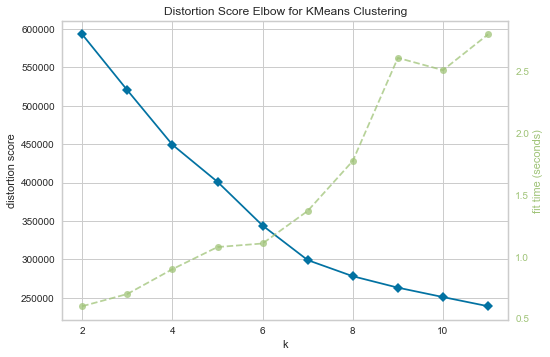

In [31]:
model = cluster.KMeans()
visualizer = KElbowVisualizer(model, k=(2,12),locate_elbow=False)

visualizer.fit(X_norm)    # Fit the data to the visualizer
visualizer.poof() 

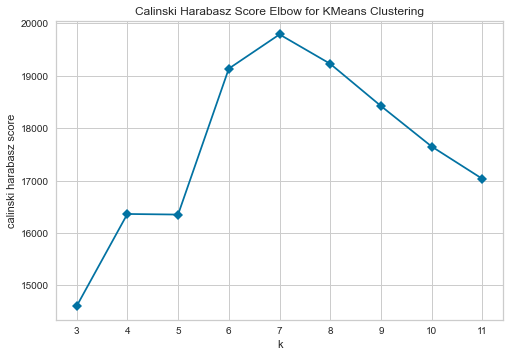

In [32]:
visualizer = KElbowVisualizer(model, k=(3,12), 
                              metric='calinski_harabasz',
                              timings=False,
                              locate_elbow=False)
visualizer.fit(X_norm)  
visualizer.poof() 

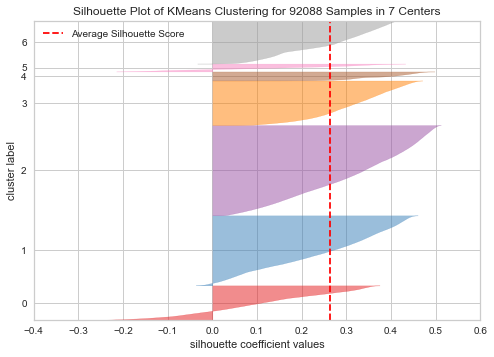

In [33]:
#silhouette plot with K=7
model = cluster.KMeans(7,random_state=0)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X_norm)    # Fit the data to the visualizer
visualizer.poof()  

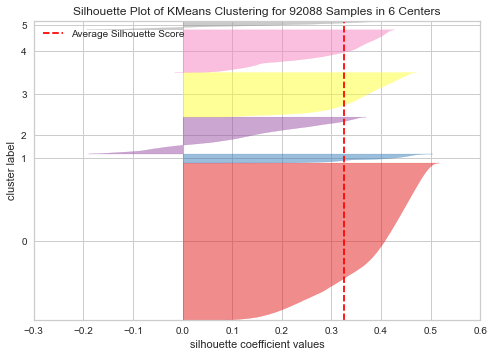

In [34]:
#silhouette plot with K=6
model = cluster.KMeans(6)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X_norm)    # Fit the data to the visualizer
visualizer.poof()  

We first try a segmentation with K=6

In [35]:
cls = cluster.KMeans(n_clusters=6, random_state=0)
cls.fit(X_norm)

KMeans(n_clusters=6, random_state=0)

In [36]:
dg['num_cluster']=cls.labels_

In [37]:
dg['num_cluster'].value_counts()

0    28738
5    22204
4    14059
1    13441
2    10857
3     2789
Name: num_cluster, dtype: int64

In [38]:
centroids = pd.DataFrame(np.round(std_sc.inverse_transform(cls.cluster_centers_), 3),
                         columns=dg.iloc[:, :-1].columns)

In [39]:
centroids.style.background_gradient(axis=0,cmap='PuBu')

,nb_of_orders,payment_type_boleto,nb_days_since_last_order,delivery_nb_of_days,payment_value,review_score,city_density,dimensions
0,1.000000,0.000000,123.597000,9.966000,146.658000,4.619000,0.981000,20225.184000
1,1.000000,0.181000,220.111000,6.921000,130.213000,4.328000,16.170000,25072.199000
2,1.000000,0.124000,233.569000,24.287000,177.223000,1.505000,1.782000,29064.093000
3,2.114000,0.189000,218.894000,11.836000,143.298000,4.205000,3.791000,28118.888000
4,1.000000,1.000000,249.752000,12.328000,131.564000,4.417000,0.821000,24441.966000
5,1.000000,0.000000,388.196000,11.697000,157.085000,4.574000,1.054000,34013.972000


Segmentation with K=7

In [18]:
cls = cluster.KMeans(n_clusters=7,random_state=0)
cls.fit(X_norm)
dg['num_cluster'] = cls.labels_

centroids = pd.DataFrame(np.round(std_sc.inverse_transform(cls.cluster_centers_),3),
                         columns=dg.iloc[:, :-1].columns)
centroids.style.background_gradient(axis=0,cmap='PuBu')

,nb_of_orders,payment_type_boleto,nb_days_since_last_order,delivery_nb_of_days,payment_value,review_score,city_density,dimensions
0,1.000000,0.123000,233.312000,24.258000,172.986000,1.503000,1.775000,21865.765000
1,1.000000,0.000000,388.507000,11.546000,148.902000,4.575000,1.051000,21561.958000
2,1.000000,0.000000,121.623000,10.029000,146.241000,4.619000,0.984000,18564.841000
3,1.000000,1.000000,249.053000,12.305000,128.871000,4.420000,0.819000,19229.825000
4,2.115000,0.189000,218.888000,11.826000,143.206000,4.205000,3.793000,26449.650000
5,1.006000,0.166000,269.385000,13.090000,272.616000,4.171000,2.861000,247042.832000
6,1.000000,0.182000,219.526000,6.881000,128.062000,4.333000,16.171000,20058.177000


This segmentation shows a cluster with most recent customers that it is interesting to keep.

In [19]:
dg['num_cluster'].value_counts(ascending=True
                            )

5     2419
4     2774
0    10600
6    13162
3    13740
1    21574
2    27819
Name: num_cluster, dtype: int64

We try to represent our clusters : 


In [42]:
from sklearn import decomposition

#We apply a PCA

n_comp = 4
pca = decomposition.PCA(n_components=n_comp)
pca.fit(X_norm)
print(pca.explained_variance_ratio_.cumsum())
X_trans = pca.transform(X_norm)

[0.19176154 0.33254247 0.47086358 0.60591556]


In [43]:
cls.cluster_centers_

array([[-1.60083013e-01, -1.90021947e-01, -2.25095637e-02,
         1.28842853e+00,  5.92658541e-02, -2.07034622e+00,
        -2.75511637e-01, -9.43336164e-02],
       [-1.60083013e-01, -4.99701452e-01,  9.94697071e-01,
        -5.45819726e-02, -5.11183171e-02,  3.29199120e-01,
        -4.00694940e-01, -1.00571744e-01],
       [-1.60083013e-01, -4.99701452e-01, -7.54559830e-01,
        -2.14788636e-01, -6.33136063e-02,  3.63280119e-01,
        -4.12396224e-01, -1.62112113e-01],
       [-1.60083013e-01,  2.00922341e+00,  8.06603021e-02,
         2.56415481e-02, -1.42926012e-01,  2.08007773e-01,
        -4.40991655e-01, -1.48457875e-01],
       [ 5.16042391e+00, -2.61437146e-02, -1.17052669e-01,
        -2.49402378e-02, -7.72252306e-02,  3.99858892e-02,
         7.37604603e-02, -2.11831627e-04],
       [-1.30456955e-01, -8.32780788e-02,  2.13928506e-01,
         1.08536672e-01,  5.15906428e-01,  1.38607938e-02,
        -8.76011407e-02,  4.52926994e+00],
       [-1.60083013e-01, -4.377588

In [44]:
np.array(dg['num_cluster'].value_counts(ascending=True).index)

array([5, 4, 0, 6, 3, 1, 2], dtype=int64)

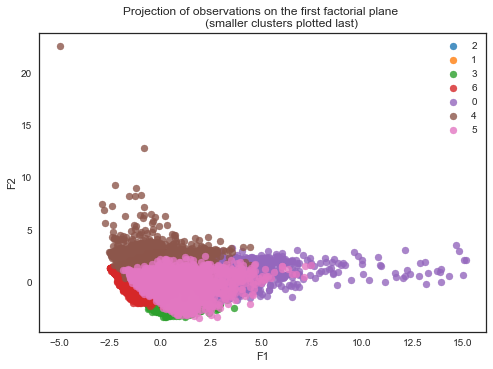

In [46]:
# First factorial plane projection, smaller clusters plotted last
sns.set_palette("tab10")
sns.set_style("ticks")
illustrative_var = np.array(cls.labels_)

for value in np.array(dg['num_cluster'].value_counts(ascending=False).index):
    selected = np.where(illustrative_var == value)
    plt.scatter(X_trans[selected, 0],
                X_trans[selected, 1],
                alpha=0.8,
                label=value)
    
plt.legend()
plt.xlabel('F1')
plt.ylabel('F2')
plt.title('Projection of observations on the first factorial plane \n \
          (smaller clusters plotted last)')
plt.show()

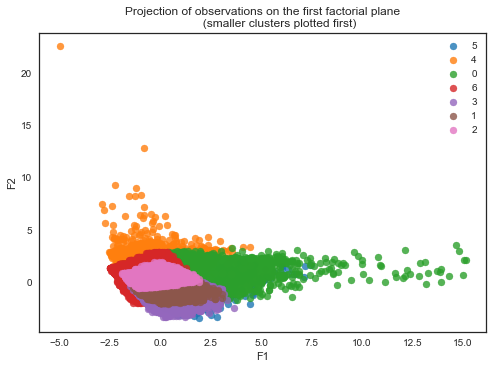

In [47]:
# First factorial plane projection, smaller clusters plotted first
sns.set_palette("tab10")
sns.set_style("ticks")
illustrative_var = np.array(cls.labels_)
for value in np.array(dg['num_cluster'].value_counts(ascending=True).index):
    selected = np.where(illustrative_var == value)
    plt.scatter(X_trans[selected, 0], X_trans[selected, 1], alpha=0.8, label=value)
    
plt.legend()
plt.xlabel('F1')
plt.ylabel('F2')
plt.title('Projection of observations on the first factorial plane\n\
          (smaller clusters plotted first)')
plt.show()

In [36]:
#projection on the top three proincipal components
import plotly.express as px
fig = px.scatter_3d(pd.DataFrame(X_trans), x=0, y=1, z=2,color=cls.labels_)
fig.update(layout_coloraxis_showscale=False)
fig.show()

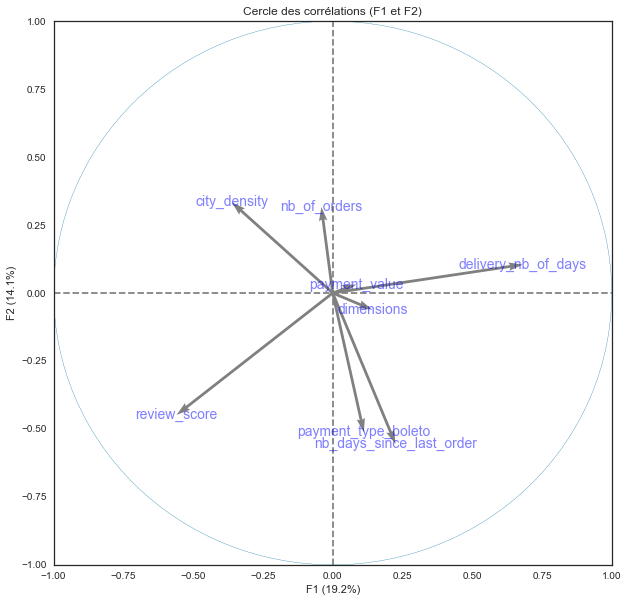

In [48]:
#Variables representation on the first factorial plan.
features=dg.iloc[:, :-1].columns
pcs = pca.components_
display_circles(pcs, n_comp, pca, [(0,1)], labels = np.array(features))

An meaning of the first principal component could be the service efficiency to the customer. 
We can interpret the second principal component as the customer loyalty.

In [97]:
# TSNE representation

In [49]:
dg_tsne = dg.sample(n=30000)

In [50]:
dg_tsne.head()

,nb_of_orders,payment_type_boleto,nb_days_since_last_order,delivery_nb_of_days,payment_value,review_score,city_density,dimensions,num_cluster
customer_unique_id,,,,,,,,,
3d8af05295416bf277278cd5bfecd970,1,0.0,404,3.0,156.51,5.0,0.284091,37026.0,1
561ccc48c5f03fb5cc10bdf7a0006ffa,1,0.0,163,29.0,197.99,5.0,0.004163,8000.0,2
4dd1d96f4d8bce0b7e0f5ed818180067,1,1.0,73,9.0,219.63,4.0,0.658716,4500.0,3
3880b8d94e3a64bca0e7df6c5f05c29a,1,1.0,314,4.0,60.94,5.0,16.171329,5832.0,6
9a3fdd4ad28fc1dc25039dd5d4a3dbbe,1,0.0,496,25.0,394.52,4.0,0.001041,23750.0,1


In [51]:
dg_tsne.reset_index(drop=True, inplace=True)

X_sample = dg_tsne.iloc[:, :-1].values

#normalize sample
X_norm_sample = std_sc.transform(X_sample)
#put it in a dataframe
dh = pd.DataFrame(X_norm_sample, 
                  columns=dg_tsne.iloc[:, :-1].columns)

#join the cluster number
dh.loc[:,'num_cluster'] = dg_tsne['num_cluster']

In [52]:
from sklearn.manifold import TSNE

In [53]:
m = TSNE(perplexity=10)
tsne_feature = m.fit_transform(dh.iloc[:, :-1])

In [55]:
dh['x'] = tsne_feature[:, 0]
dh['y'] = tsne_feature[:, 1]

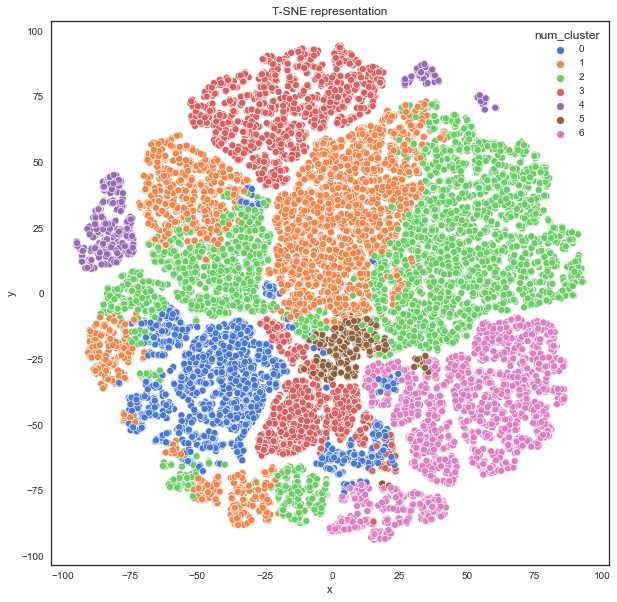

In [56]:
plt.figure(figsize=(10, 10))
sns.scatterplot(x='x', y='y', data=dh, hue='num_cluster', palette='muted')
plt.xlabel('x')
plt.ylabel('y')
plt.title('T-SNE representation')
plt.show()


We have quite a good sepration of clusters despite some dispersion.

### Third segmentation :

We keep the same variables as before: number of orders, average number of payment types by boleto, average delivery number of days, average number of days since order, average payment value,average review score, city density and average dimensions of items. We are going to try a DBSCAN segmentation

In [57]:
from sklearn.cluster import DBSCAN

We use the method explained in this [review](https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc#:~:text=DBSCAN%20works%20by%20determining%20whether,maximum%20distance%20between%20two%20points.) to find the optimal value of espilon hyperparameter of the DBSCAN algorithm. We calculate, for each point the distance to its nearest neighbour.  Then we plot the ordered distances and take as epsilon the value of maximum curvation.


In [58]:
from sklearn.neighbors import NearestNeighbors

neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_norm)
distances, indices = nbrs.kneighbors(X_norm)

In [59]:
distances

array([[0.        , 0.02783831],
       [0.        , 0.1019083 ],
       [0.        , 0.27070483],
       ...,
       [0.        , 0.13159622],
       [0.        , 0.05782106],
       [0.        , 0.04066632]])

In [60]:
indices

array([[    0, 28123],
       [    1, 42437],
       [    2, 83104],
       ...,
       [92085, 28406],
       [92086, 17574],
       [92087, 87506]], dtype=int64)

In [61]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]


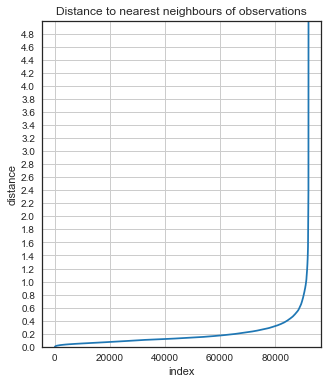

In [62]:
plt.figure(figsize=(5, 6))

plt.ylim(0, 5)
plt.yticks(np.arange(0, 5, 0.2))
plt.grid()
plt.plot(distances)
plt.xlabel('index')
plt.ylabel('distance')
plt.title('Distance to nearest neighbours of observations')
plt.show()

We choose epsilon=0.5

In [63]:
#test with min_samples=5
dbscan=DBSCAN(eps=0.5, min_samples=5)
dbscan.fit(X_norm)
dg['num_cluster']=dbscan.labels_
u_5=dg['num_cluster'].value_counts()

In [64]:
u_5[:20]

 0     47300
 1     10555
-1      8002
 3      6713
 2      4621
 16     2664
 4      2000
 14     1335
 10     1045
 5       999
 11      973
 6       884
 8       727
 7       705
 9       489
 28      426
 15      421
 19      271
 12      265
 26      205
Name: num_cluster, dtype: int64

In [65]:
#test with min_samples=4
dbscan=DBSCAN(eps=0.5, min_samples=4)
dbscan.fit(X_norm)
dg['num_cluster']=dbscan.labels_
u_4=dg['num_cluster'].value_counts()

In [66]:
u_4[:20]

 0     47519
 1     10599
-1      7141
 3      6757
 2      4655
 17     2673
 4      2009
 14     1350
 10     1055
 5      1009
 11      990
 6       919
 8       734
 7       728
 9       499
 15      429
 32      426
 20      285
 12      275
 21      215
Name: num_cluster, dtype: int64

In [67]:
len(u_4)

207

we choose min_samples=4: we can keep more observations in the biggest clusters (except noise) compared to min_samples=5.

In [68]:
#select representative clusters
L=dg['num_cluster'].value_counts()
liste_index=L[L>1500].index.tolist()
liste_index.remove(-1)

In [69]:
print(liste_index)

[0, 1, 3, 2, 17, 4]


In [70]:
#select data
dh=dg[dg['num_cluster'].isin(liste_index)]

In [71]:
dg.head()

,nb_of_orders,payment_type_boleto,nb_days_since_last_order,delivery_nb_of_days,payment_value,review_score,city_density,dimensions,num_cluster
customer_unique_id,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,0.0,111,6.0,141.90,5.0,0.105103,34816.0,0
0000b849f77a49e4a4ce2b2a4ca5be3f,1,0.0,114,3.0,27.19,4.0,0.776307,8424.0,0
0000f46a3911fa3c0805444483337064,1,0.0,536,25.0,86.22,3.0,0.175866,30625.0,0
0000f6ccb0745a6a4b88665a16c9f078,1,0.0,320,20.0,43.62,4.0,0.465160,2299.0,0
0004aac84e0df4da2b147fca70cf8255,1,0.0,287,13.0,196.89,5.0,0.658716,1936.0,0


In [72]:
dh.shape

(74212, 9)

In [73]:
# t sne-representation

In [74]:
dh_tsne=dh.sample(n=30000)
dh_tsne.reset_index(drop=True, inplace=True)

X_sample=dh_tsne.iloc[:, :-1].values
X_norm_sample=std_sc.transform(X_sample)

dk=pd.DataFrame(X_norm_sample,columns=dh_tsne.iloc[:, :-1].columns)

dk.loc[:, 'num_cluster']=dh_tsne['num_cluster']

In [75]:
from sklearn.manifold import TSNE

m=TSNE(perplexity=30)
tsne_features=m.fit_transform(dk.iloc[:, :-1])

In [76]:
dk['x'] = tsne_features[:, 0]
dk['y'] = tsne_features[:, 1]

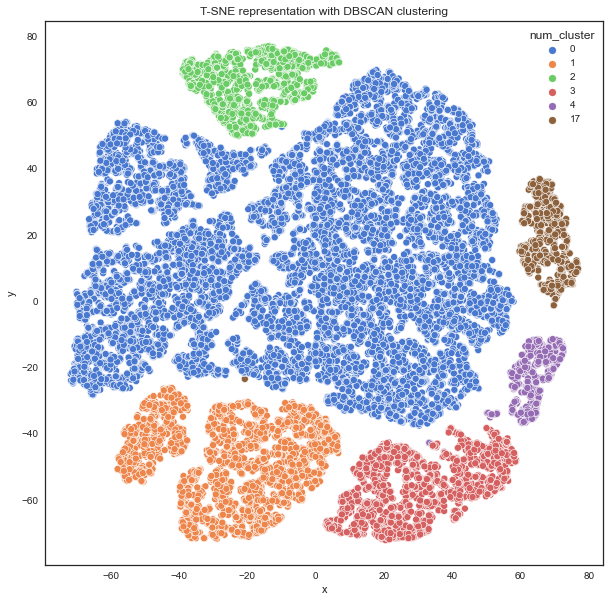

In [77]:
plt.figure(figsize=(10, 10))
sns.scatterplot(x='x', y='y',data=dk, hue='num_cluster', palette='muted')
plt.title('T-SNE representation with DBSCAN clustering')
plt.show()

In [80]:
#Mean values in each cluster
pd.DataFrame(dh.groupby('num_cluster')[['payment_type_boleto',
                                        'nb_of_orders',
                                        'payment_value',
                                        'review_score',
                                        'delivery_nb_of_days',
                                        'city_density',
                                        'nb_days_since_last_order',
                                        'dimensions']]
                                        .median())\
                                        .style.background_gradient(axis=0,\
                                                                   cmap='PuBu')


,payment_type_boleto,nb_of_orders,payment_value,review_score,delivery_nb_of_days,city_density,nb_days_since_last_order,dimensions
num_cluster,,,,,,,,
0,0.000000,1,105.370000,5.000000,10.000000,0.167541,217,8448.000000
1,1.000000,1,87.640000,5.000000,11.000000,0.121753,230,8000.000000
2,0.000000,1,114.150000,1.000000,16.000000,0.192516,197,8000.000000
3,0.000000,1,87.760000,5.000000,5.000000,16.171329,189,8000.000000
4,0.000000,1,85.810000,4.000000,6.000000,16.171329,198,8000.000000
17,0.000000,1,102.880000,5.000000,9.000000,7.161588,231,8000.000000


### Model selection and analysis

We select the model of the second segmentation: Kmeans with K=7, with the following variables: number of orders, average number of payment types by boleto, average delivery number of days, average number of days since order, average payment value,average review score, city density and average dimensions of items.

In [81]:
#re-define the cluster number with the selected model.
dg['num_cluster'] = cls.labels_

In [82]:
# merge with defined variables
dg_analysis = pd.merge(dg,dg_init[['category_other',
                                 'category_kids',
                                 'category_hobbies',
                                 'category_furnitures_deco',
                                 'category_food',
                                 'category_fashion_beauty',
                                 'category_electronic',
                                 'category_diy',
                                 'category_auto',
                                 'category_accessories',
                                 'category_services',
                                 'payment_type_debit_card',
                                 'payment_type_credit_card',
                                 'payment_type_voucher',
                                 'nb_payments',
                                 'nb_items']], 
                       on='customer_unique_id',
                       how='inner')

In [86]:
## Payment types by cluster
dg_analysis.groupby('num_cluster')[['payment_type_boleto',
                                    'payment_type_debit_card',
                                    'payment_type_credit_card',
                                    'payment_type_voucher']]\
                                    .mean()\
                                    .style.background_gradient(axis=None,cmap='hot_r')

,payment_type_boleto,payment_type_debit_card,payment_type_credit_card,payment_type_voucher
num_cluster,,,,
0,0.123679,0.014340,0.848679,0.063491
1,0.000000,0.010476,0.973394,0.080606
2,0.000000,0.025882,0.959812,0.059851
3,1.000000,0.000000,0.000000,0.000000
4,0.188749,0.013759,0.775412,0.082484
5,0.165771,0.013642,0.813973,0.077718
6,0.181735,0.019678,0.784683,0.052044


In [87]:
#Import orders with their characteristics
df = pd.read_pickle('df_orders.pkl')
df.head()

,customer_id,customer_unique_id,city,order_id,order_purchase_timestamp,order_delivered_customer_date,delivery_nb_of_days,nb_days_since_order,payment_value,payment_type_boleto,...,category_furnitures_deco,category_food,category_fashion_beauty,category_electronic,category_diy,category_auto,category_accessories,category_services,review_score,city_density
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,franca,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,2017-05-25 10:35:35,8.0,469,146.87,0.0,...,1,0,0,0,0,0,0,0,4.0,0.167541
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,sao bernardo do campo,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,2018-01-29 12:41:19,16.0,228,335.48,0.0,...,0,0,0,0,0,0,1,0,5.0,0.976107
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,sao paulo,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,2018-06-14 17:58:51,26.0,101,157.73,0.0,...,1,0,0,0,0,0,0,0,5.0,16.171329
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,mogi das cruzes,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,2018-03-28 16:04:25,14.0,168,173.30,0.0,...,1,0,0,0,0,0,0,0,5.0,0.398560
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,campinas,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,2018-08-09 20:55:48,11.0,31,252.25,0.0,...,1,0,0,0,0,0,0,0,5.0,1.502664


In [91]:
#Join category names to orders
items = pd.read_csv('olist_order_items_dataset.csv')

products = pd.read_csv('olist_products_dataset.csv')

products_orders = pd.merge(items[['product_id',
                                  'order_id']],
                           products[['product_id',
                                     'product_category_name']],
                           on='product_id',
                           how='inner')

products_orders['category'] = products_orders['product_category_name']\
                             .apply(category)

df = pd.merge(df,
              products_orders[['order_id','product_category_name','category']],
              on='order_id',
              how='left')

In [93]:
# join categroy names to customers_unique_id
df = pd.merge(dg, df, on='customer_unique_id', how='inner')

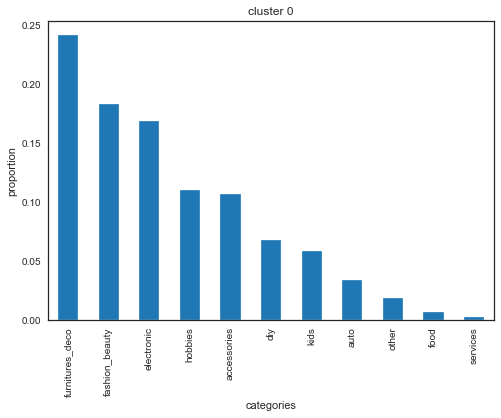

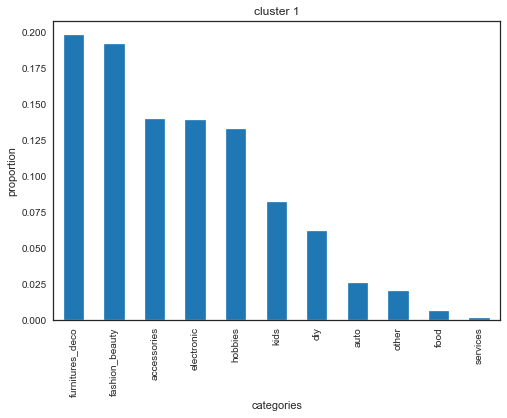

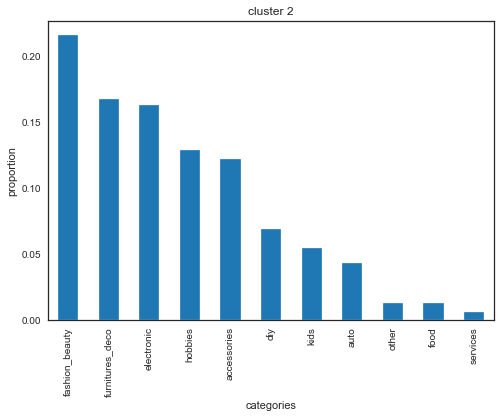

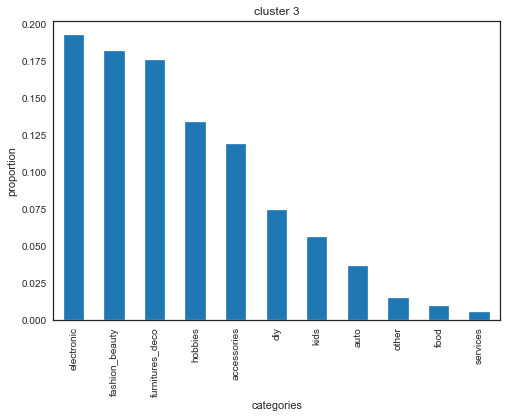

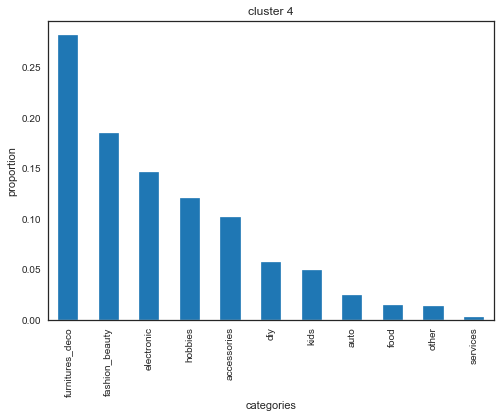

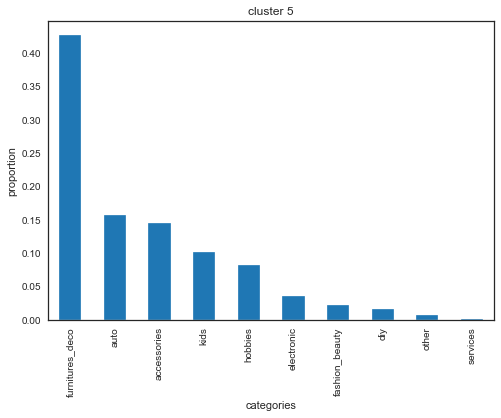

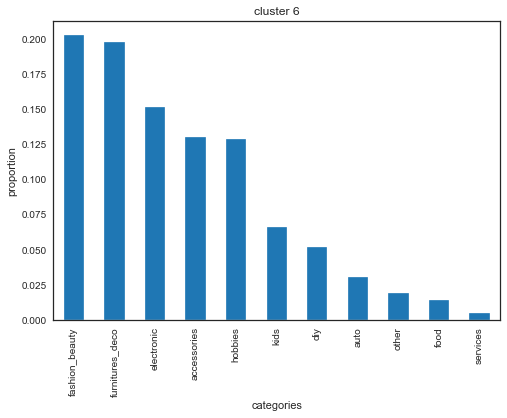

In [96]:
# Most pouplar categories by cluster
for i in range(7):
    df[df['num_cluster']==i]['category']\
                                .value_counts(normalize=True)\
                                .plot(kind='bar')  
    plt.title('cluster {}'.format(i))
    plt.xlabel('categories')
    plt.ylabel('proportion')
    print('\n\n')
    plt.show()
    

In [53]:
#radar plot
import plotly.graph_objects as go
import plotly.offline as pyo


categories = centroids.columns.tolist()
categories = [*categories, categories[0]]

for i in range(7):
    globals()['C_'+str(i)] = cls.cluster_centers_[i].tolist()
    globals()['C_'+str(i)] = [*globals()['C_'+str(i)],
                              globals()['C_'+str(i)][0]]

fig = go.Figure(
    data=[
        go.Scatterpolar(r=globals()['C_'+ str(i)],
                        theta=categories,
                        fill='toself',
                        name='cluster_'+ str(i))
        for i in range(6,-1,-1)
    ],
    layout=go.Layout(
        title=go.layout.Title(text='Cluster comparison'),
        polar={'radialaxis': {'visible': True},
               'angularaxis': {'tickfont': {'size':20}}},
        showlegend=True
                   )
                 )

fig.update_layout(legend=dict(orientation="h",
                              yanchor="bottom",
                              y=-0.2,
                              xanchor="right",
                              x=1
                              )
                 )


pyo.plot(fig)

'temp-plot.html'

In [2]:
len('aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaa')

79

### Stability

In [29]:
n,u=stability()

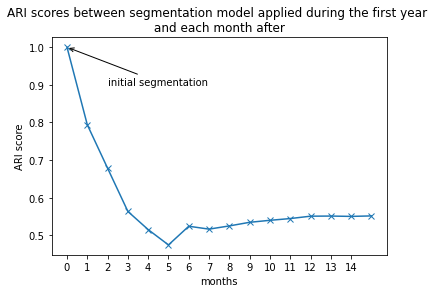

In [30]:
plt.plot(n,u,marker='x')
plt.xticks(np.arange(0,15,1))
plt.title('ARI scores between segmentation model applied during the first year \n and each month after ')
plt.xlabel('months')
plt.ylabel('ARI score')
plt.annotate('initial segmentation', xy=(0, 1), xytext=(2,0.9),
            arrowprops=dict(arrowstyle="->"))
#plt.grid()
plt.show()